# Deep Learning & Applied AI

We reccomend to go through the notebook using Google Colaboratory.

# Tutorial 6: Convolutional neural networks

In this tutorial, we will cover:

- Convolutional neural networks
- Residual networks

Our info:

- Luca Moschella (moschella@di.uniroma.it)
- Antonio Norelli (norelli@di.uniroma1.it)

Course:

- Website and notebooks will be available at [DLAI-s2-2020](https://erodola.github.io/DLAI-s2-2020/)

##Import dependencies (run the following cells)

In [0]:
# @title import dependencies

from typing import Mapping, Union, Optional

import numpy as np
import argparse
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import plotly.graph_objects as go
import torchvision
from torchvision import datasets, models, transforms
import os
from tqdm.notebook import tqdm

from __future__ import print_function, division

In [0]:
# @title reproducibility stuff

import random
torch.manual_seed(42)
np.random.seed(42)
random.seed(0)

torch.cuda.manual_seed(0)
torch.backends.cudnn.deterministic = True  # Note that this Deterministic mode can have a performance impact
torch.backends.cudnn.benchmark = False

##Intro

Today we start going back to March 2016. 

Do you remember this match?

![AlphaGo](https://mediad.publicbroadcasting.net/p/shared/npr/201805/470700854.jpg)



For the first time an artificial intelligence defeated a Go world champion, Lee Sedol, a feat that was previously believed to be at least a decade away. 
This event is already a milestone in AI research.

A fundamental ingredient of AlphaGo was a neural network architecture that at that time was already revolutionizing the field of computer vision; Convolutional Neural Networks.

The huge complexity of the patterns on a Go board was caught with success using the same general priors proved effective in classifying real world images.


Today we will explore this architecture and one of its evolution, Residual Convolutional Neural Networks, the one used in AlphaGo.

If you want to re-experience the AI conquer of the most ancient of games, a very nice documentary about that match is now [free on YouTube](https://www.youtube.com/watch?v=WXuK6gekU1Y)!



##CNNs: a fundamental idea at the core of deep learning

Convolutional neural networks are a way of exploiting a known prior about our problem. Actually, a whole set of priors at the same time:
- Translational equivariance
- Compositionality
- Locality
- Self-similarity

> **EXERCISE**: Consider the problem of recognizing objects in images. Looking at the following example, discuss how all these priors apply.
> 
>![polyfit matrix notation](https://drive.google.com/uc?export=view&id=1SLeKcN9EAYhy98aaPjxfS7uRyypSSwKS)

In [0]:
# @title Solution 👀
# """
# - Translational equivariance: A book upper left is still a book down right.
# - Compositionality: The table is composed by legs, recognizing the legs helps in recognizing the table
# - Locality: To recognize an eye you need only pixels locally concentrated in a spot on the image.
# - Self-similarity: You can recognize the two eyes using a single eye-recognizer
# """

>Think about the convolution operation as a **fundamental idea at the core of deep learning** more than a nice trick to exploit known but not essential priors.

These priors are so general and training a deep MLP is so hard that a large part of deep learning applications would be not possible without CNNs.




### People have the priors[!](https://www.youtube.com/watch?v=pPR-HyGj2d0)

As already pointed out, recognizing the prior knowledge you have about your  problem is crucial for any learning project.

In this section we are going to list many learning problems, asking to you whether the priors discussed in the previous section apply, and if we can use the standard CNNs to exploit them.
> **EXERCISE**: For each of the subsequent learning problems, choose one of the following
> 1. The priors apply and we can use standard CNNs.
> 2. The priors apply but we need to define a new way of doing convolution on this kind of data.
> 3. The priors do not apply.

> Problems:
> - Classify handwritten digits (MNIST)
> - Classify handwritten digits from a random permutation of the pixels in the input image (think about a random permutation of the 784 entries in a vector encoding a MNIST image)
> - Classify noisy handwritten digits (think about MNIST with a random 10% of the pixels set to white)
> - Evaluate a chess position from the perspective of the white player (think about a dataset composed of games played by masters in the form of $(s, z)$, where $s$ is a proper representation of a game state (the chessboard) and $z$ encodes the outcome respect to white, e.g. $z=+1,-1,0$ in case of victory, defeat, draw).
> - Classify rigid 3D objects like planes or tables (think about the [ShapeNet](https://www.shapenet.org/taxonomy-viewer) dataset)
> - Classify the vertices of a human mesh as belonging to the arms or not (think about the [FAUST](http://faust.is.tue.mpg.de/overview) dataset).
> - Predicting the political orientation of a user solely based on the network of its friends on a social.
> - Classify the musical instruments in a song.
> - Evaluate the price of an house in California (think about a dataset with features like *longitude*, *latitude*, *number of rooms*, *close to the ocean*,... like [this one](https://www.kaggle.com/camnugent/california-housing-prices))
> - Predicting interactions between proteins and other biomolecules solely based on structure.
> - Evaluate the richness of a territory solely based on satellite images.
> - Predicting the science field of a paper solely based on the citation network (think about the [CORA](https://relational.fit.cvut.cz/dataset/CORA) dataset) 

> ***Note***: we do not provide the solutions to this exercise, but we encourage you to send your solutions by email to us, discussing the ones that made you think most in a couple of lines.


## Convolutional Neural Networks in practice

Building a CNN today is very easy thanks to modern deep learning programming frameworks. As you have seen in the last notebook, the `torch.nn` package reduces the introduction of a convolution transformation to a single call to a function  (e.g. ```nn.Conv2d```  for 2D data). 

Nevertheless, CNNs involve many different operations and non-trivial changing in shape of the input tensor through the layers. 

Keep in mind the two basic transformations introduced by CNNs:
- Convolution 

![conv](https://upload.wikimedia.org/wikipedia/commons/1/19/2D_Convolution_Animation.gif)
- Pooling (Max pooling in the example below)

![pooling](https://upload.wikimedia.org/wikipedia/commons/e/e9/Max_pooling.png)

*Images from Wikipedia*



In this section we'll see how incorporating the right prior helps us, if they hold. If our assumptions are not true, they will bite us hard.

We need to make just the right amount of assumptions, not more than that.

In [0]:
# Just a function to count the number of parameters
def count_parameters(model: torch.nn.Module) -> int:
  """ Counts the number of trainable parameters of a module
  
  :param model: model that contains the parameters to count
  :returns: the number of parameters in the model
  """
  return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [0]:
# Define the device to use: use the gpu runtime if possible!
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f'Using device: {device}') 

Using device: cuda:0


### Load the dataset CIFAR-10
The CIFAR-10 dataset consists of 60000 32x32 colour images in 10 classes, with 6000 images per class. There are 50000 training images and 10000 test images.

We will use some PyTorch utilities to download, shuffle, normalize the data and arrange it in batches.


In [0]:
# Totally arbitrary transformations 
# You can do better! e.g. compute the mean and std of the train dataset
image_transforms = transforms.Compose(
    [
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5,), std=(0.5,)),
    ]
)

train_loader = torch.utils.data.DataLoader(
    datasets.CIFAR10(
        "../data",
        train=True,
        download=True,
        transform=image_transforms
    ),
    batch_size=64,
    shuffle=True,
)

test_loader = torch.utils.data.DataLoader(
    datasets.CIFAR10(
        "../data",
        train=False,
        transform=image_transforms
    ),
    batch_size=1000,
    shuffle=True,
)

# Retrieve the image size and the number of color channels
x, _ = next(iter(train_loader))

n_channels = x.shape[1]
input_size_w = x.shape[2]
input_size_h = x.shape[3]
input_size = input_size_w * input_size_h

# Specify the number of classes in CIFAR10
output_size = 10  # there are 10 classes
output_classes = ('plane', 'car', 'bird', 'cat', 'deer', 
                  'dog', 'frog', 'horse', 'ship', 'truck')

Extracting ../data/cifar-10-python.tar.gz to ../data


In [0]:
# We can still access our dataset
train_loader.dataset

Dataset CIFAR10
    Number of datapoints: 50000
    Root location: ../data
    Split: Train
    StandardTransform
Transform: Compose(
               Grayscale(num_output_channels=1)
               ToTensor()
               Normalize(mean=(0.5,), std=(0.5,))
           )

In [0]:
# @title Dataset examples { run: "auto" }

import plotly.express as px

training_index = 36079  #@param {type:"slider", min:0, max:50000, step:1}
image, label = train_loader.dataset[training_index]

antbee_example = np.array(image[0])

fig = px.imshow(antbee_example, 
                title=output_classes[label],
                color_continuous_scale='gray', 
                color_continuous_midpoint=0)
fig.show()

### Define the model classes

We're going to compare the performance of a classic MLP model with a model that uses convolutions.

The model are defined as follows:

In [0]:
class FC2Layer(nn.Module):
    def __init__(
        self, input_size: int, input_channels: int, n_hidden: int, output_size: int
    ) -> None:
        """
        Simple MLP model

        :param input_size: number of pixels in the image
        :param input_channels: number of color channels in the image
        :param n_hidden: size of the hidden dimension to use
        :param output_size: expected size of the output
        """
        super().__init__()
        self.network = nn.Sequential(
            nn.Linear(input_size * input_channels, n_hidden),
            nn.ReLU(),
            nn.Linear(n_hidden, n_hidden),
            nn.ReLU(),
            nn.Linear(n_hidden, output_size),
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        """
        :param x: batch of images with size [batch, 1, w, h]

        :returns: predictions with size [batch, output_size]
        """
        x = x.view(x.shape[0], -1)
        o = self.network(x)
        return o


class CNN(nn.Module):
    def __init__(
        self, input_size: int, input_channels: int, n_feature: int, output_size: int
    ) -> None:
        """
        Simple model that uses convolutions

        :param input_size: number of pixels in the image
        :param input_channels: number of color channels in the image
        :param n_feature: size of the hidden dimensions to use
        :param output_size: expected size of the output
        """
        super().__init__()
        self.n_feature = n_feature
        self.conv1 = nn.Conv2d(
            in_channels=input_channels, out_channels=n_feature, kernel_size=3
        )
        self.conv2 = nn.Conv2d(n_feature, n_feature, kernel_size=3)
        self.conv3 = nn.Conv2d(n_feature, n_feature, kernel_size=3)

        self.fc1 = nn.Linear(n_feature * 5 * 5, 10)
        self.fc2 = nn.Linear(10, 10)

    def forward(self, 
                x: torch.Tensor, 
                return_conv1: bool = False, 
                return_conv2: bool = False, 
                return_conv3: bool = False
        ) -> torch.Tensor:
        """
        :param x: batch of images with size [batch, 1, w, h]
        :param return_conv1: if True return the feature maps of the first convolution
        :param return_conv2: if True return the feature maps of the second convolution
        :param return_conv3: if True return the feature maps of the third convolution

        :returns: predictions with size [batch, output_size]
        """
        x = self.conv1(x)
        if return_conv1:
            return x
        x = F.relu(x)
        x = F.max_pool2d(x, kernel_size=2)

        x = self.conv2(x)
        if return_conv2:
            return x
        x = F.relu(x)

        # Not so easy to keep track of shapes... right?
        # An useful trick while debugging is to feed the model a fixed sample batch
        # and print the shape at each step, just to be sure that they match your expectations.

        # print(x.shape)

        x = self.conv3(x)
        if return_conv3:
            return x
        x = F.relu(x)
        x = F.max_pool2d(x, kernel_size=2)

        x = x.view(x.shape[0], -1)
        x = self.fc1(x)
        x = F.relu(x)
        x = self.fc2(x)
        return x

# A fixed sample batch
# x, _ = next(iter(train_loader))
# model = CNN(input_size, n_channels, 9, 10)
# _ = model(x)

### Training utility functions

Let's define some utility functions, we'll use them to simplify the training of different models on different datasets.

We will need:
- A function to permute the pixels of every image in a batch given a fixed permutation (this will be useful later for an experiment)
- One function to train the model and evaluate it

---

*Remember*: you should not memorize the code, just as you do not memorize formulas. You should be able to write it on your own after you understand what it does. Learn what it is possible to do, what should be possible to do and what you need, then... just search for the stuff you need in the docs, google or stackoverflow.

If you are troubled when solving algorithmic problems, you can have some fun on [LeetCode](https://leetcode.com/problemset/algorithms/).

![](https://imgs.xkcd.com/comics/wisdom_of_the_ancients.png)

In [0]:
import torch
import torch.nn.functional as F
from typing import Optional, Callable
from tqdm.notebook import tqdm, trange


def permute_pixels(images: torch.Tensor, perm: Optional[torch.Tensor]) -> torch.Tensor:
    """ Permutes the pixel in each image in the batch

    :param images: a batch of images with shape [batch, channels, w, h]
    :param perm: a permutation with shape [w * h]

    :returns: the batch of images permuted according to perm
    """
    if perm is None:
        return images

    batch_size = images.shape[0]
    n_channels = images.shape[1]
    w = images.shape[2]
    h = images.shape[3]
    images = images.view(batch_size, n_channels, -1)
    images = images[..., perm]
    images = images.view(batch_size, n_channels, w, h)
    return images


def make_averager() -> Callable[[Optional[float]], float]:
    """ Returns a function that maintains a running average

    :returns: running average function
    """
    count = 0
    total = 0

    def averager(new_value: Optional[float]) -> float:
        """ Running averager

        :param new_value: number to add to the running average,
                          if None returns the current average
        :returns: the current average
        """
        nonlocal count, total
        if new_value is None:
            return total / count if count else float("nan")
        count += 1
        total += new_value
        return total / count

    return averager


def fit(
    epochs: int,
    train_dl: torch.utils.data.DataLoader,
    test_dl: torch.utils.data.DataLoader,
    model: torch.nn.Module,
    opt: torch.optim.Optimizer,
    tag: str,
    perm: Optional[torch.Tensor] = None,
    device: str = "cuda",
) -> float:
    """ Train the model and computes metrics on the test_loader at each epoch

    :param epochs: number of epochs
    :param train_dl: the train dataloader
    :param test_dl: the test dataloader
    :param model: the model to train
    :param opt: the optimizer to use to train the model
    :param tag: description of the current model
    :param perm: if not None, permute the pixel in each image according to perm

    :returns: accucary on the test set in the last epoch
    """
    for epoch in trange(epochs, desc="train epoch"):
        model.train()
        train_loss_averager = make_averager()  # mantain a running average of the loss

        # TRAIN
        tqdm_iterator = tqdm(
            enumerate(train_dl),
            total=len(train_dl),
            desc=f"batch [loss: None]",
            leave=False,
        )
        for batch_idx, (data, target) in tqdm_iterator:
            # send to device
            data, target = data.to(device), target.to(device)

            if perm is not None:
                data = permute_pixels(data, perm)

            output = model(data)
            loss = F.cross_entropy(output, target)
            loss.backward()
            opt.step()
            opt.zero_grad()

            train_loss_averager(loss.item())

            tqdm_iterator.set_description(
                f"train batch [avg loss: {train_loss_averager(None):.3f}]"
            )
            tqdm_iterator.refresh()

        # TEST
        model.eval()
        test_loss_averager = make_averager()  # mantain a running average of the loss
        correct = 0
        for data, target in test_dl:
            # send to device
            data, target = data.to(device), target.to(device)

            if perm is not None:
                data = permute_pixels(data, perm)

            output = model(data)

            test_loss_averager(F.cross_entropy(output, target))

            # get the index of the max probability
            pred = output.max(1, keepdim=True)[1]
            correct += pred.eq(target.view_as(pred)).cpu().sum().item()

        accuracy = 100.0 * correct / len(test_dl.dataset)

        print(
            f"Epoch: {epoch}\n"
            f"Train set: Average loss: {train_loss_averager(None):.4f}\n"
            f"Test set: Average loss: {test_loss_averager(None):.4f}, "
            f"Accuracy: {correct}/{len(test_dl.dataset)} ({accuracy:.0f}%)\n"
        )
    models_accuracy[tag] = accuracy
    return accuracy


def get_model_optimizer(model: torch.nn.Module) -> torch.optim.Optimizer:
    """
    Encapsulate the creation of the model's optimizer, to ensure that we use the
    same optimizer everywhere

    :param model: the model that contains the parameter to optimize

    :returns: the model's optimizer
    """
    return optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
    # return optim.SGD(model.parameters(), lr=0.01, momentum=0.1, weight_decay=1e-5)


Training hyperparameters:

In [0]:
# Define the number of the epochs
epochs = 4

# Number of hidden units for the MLP
n_hidden = 9 

# Number of the feature maps in the CNN
n_features = 6

# Define a dictionary that will contain the performance of the different models
models_accuracy = {}

#### CIFAR-10

In this section we will train our MLP and CNN on the train set of the CIFAR-10,
and evaluate them on the test set.

##### Small fully-connected network

In [0]:
model_fnn = FC2Layer(input_size, n_channels, n_hidden, output_size)
model_fnn.to(device)
optimizer = get_model_optimizer(model_fnn)

print(f'Number of parameters: {count_parameters(model_fnn)}')

fit(epochs=epochs, 
    train_dl=train_loader,
    test_dl=test_loader,
    model=model_fnn,
    opt=optimizer, 
    tag='fnn',
    device=device)

Number of parameters: 9415


Epoch: 0
Train set: Average loss: 2.0722
Test set: Average loss: 1.9697, Accuracy: 2858/10000 (29%)



Epoch: 1
Train set: Average loss: 1.9394
Test set: Average loss: 1.9176, Accuracy: 3113/10000 (31%)



Epoch: 2
Train set: Average loss: 1.9037
Test set: Average loss: 1.9015, Accuracy: 3158/10000 (32%)



Epoch: 3
Train set: Average loss: 1.8857
Test set: Average loss: 1.8902, Accuracy: 3181/10000 (32%)




31.81

##### ConvNet with less parameters


In [0]:
model_cnn = CNN(input_size, n_channels, n_features, output_size)
model_cnn.to(device)
optimizer = get_model_optimizer(model_cnn)

print(f'Number of parameters: {count_parameters(model_cnn)}')

fit(epochs=epochs, 
    train_dl=train_loader,
    test_dl=test_loader,
    model=model_cnn,
    opt=optimizer, 
    tag='cnn',
    device=device)

Number of parameters: 2340


Epoch: 0
Train set: Average loss: 1.9925
Test set: Average loss: 1.8071, Accuracy: 3439/10000 (34%)



Epoch: 1
Train set: Average loss: 1.7558
Test set: Average loss: 1.7150, Accuracy: 3678/10000 (37%)



Epoch: 2
Train set: Average loss: 1.6712
Test set: Average loss: 1.6498, Accuracy: 3997/10000 (40%)



Epoch: 3
Train set: Average loss: 1.6254
Test set: Average loss: 1.6232, Accuracy: 4099/10000 (41%)




40.99

The ConvNet performs better with **fewer parameters**, thanks to its use of priors!

In [0]:
print(f'FNN number of parameters: {count_parameters(model_fnn)}')
print(f'CNN number of parameters: {count_parameters(model_cnn)}')

FNN number of parameters: 9415
CNN number of parameters: 2340


####  Scrambled CIFAR-10

What happens if our assumptions are no longer true?
Let's try to randomly permute the pixels in each image, this will **break our assumptions of real-world images**!

We will use a fixed permutation to shuffle the pixels:

In [0]:
# Define a permutation of the pixels
perm = torch.randperm(input_size) 
perm

tensor([ 21, 939, 394,  ..., 794, 226, 492])

In [0]:
# @title Scrambled dataset examples { run: "auto" }

import plotly.express as px

training_index = 34854  #@param {type:"slider", min:0, max:50000, step:1}

image, label = train_loader.dataset[training_index]
image_perm = permute_pixels(image[None, :], perm).squeeze(dim=0)

# To plot a colored image, just use: torch.einsum('cwh -> whc', image)
fig = px.imshow(image[0], 
                title=output_classes[label],
                color_continuous_scale='gray', 
                color_continuous_midpoint=0
                )
fig.show()

fig = px.imshow(image_perm[0], 
                title=f'Scrambled {output_classes[label]}',
                color_continuous_scale='gray', 
                color_continuous_midpoint=0)
fig.show()

##### Small fully-connected network

In [0]:
model_scrambled_fnn = FC2Layer(input_size, n_channels, n_hidden, output_size)
model_scrambled_fnn.to(device)
optimizer = get_model_optimizer(model_scrambled_fnn)

print(f'Number of parameters: {count_parameters(model_scrambled_fnn)}')

fit(epochs=epochs, 
    train_dl=train_loader,
    test_dl=test_loader,
    model=model_scrambled_fnn,
    opt=optimizer, 
    tag='scrambled_fnn',
    perm=perm,   # permute the images
    device=device)

Number of parameters: 9415


Epoch: 0
Train set: Average loss: 2.0556
Test set: Average loss: 1.9591, Accuracy: 3092/10000 (31%)



Epoch: 1
Train set: Average loss: 1.9292
Test set: Average loss: 1.9132, Accuracy: 3202/10000 (32%)



Epoch: 2
Train set: Average loss: 1.8911
Test set: Average loss: 1.8916, Accuracy: 3220/10000 (32%)



Epoch: 3
Train set: Average loss: 1.8686
Test set: Average loss: 1.8780, Accuracy: 3281/10000 (33%)




32.81

##### ConvNet with less parameters


In [0]:
model_scrambled_cnn = CNN(input_size, n_channels, n_features, output_size)
model_scrambled_cnn.to(device)
optimizer = get_model_optimizer(model_scrambled_cnn)

print(f'Number of parameters: {count_parameters(model_scrambled_cnn)}')

fit(epochs=epochs, 
    train_dl=train_loader,
    test_dl=test_loader,
    model=model_scrambled_cnn,
    opt=optimizer, 
    tag='scrambled_cnn',
    perm=perm,  # permute the images
    device=device)

Number of parameters: 2340


Epoch: 0
Train set: Average loss: 2.1919
Test set: Average loss: 2.0843, Accuracy: 2310/10000 (23%)



Epoch: 1
Train set: Average loss: 2.0501
Test set: Average loss: 2.0233, Accuracy: 2587/10000 (26%)



Epoch: 2
Train set: Average loss: 1.9970
Test set: Average loss: 1.9752, Accuracy: 2800/10000 (28%)



Epoch: 3
Train set: Average loss: 1.9681
Test set: Average loss: 1.9600, Accuracy: 2806/10000 (28%)




28.06

##### Performance comparison


CNN's performance drops when we permute the pixels, but the Fully-Connected Network's performance stays the same

- CNN makes the assumption that pixels lie on a grid and patterns are stationary/local and loses performance when this assumption is wrong

The fully-connected network does not make this assumption
- It does less well when it is true, since it doesn't take advantage of this prior knowledge but it doesn't suffer when the assumption is wrong



In [0]:
import plotly.express as pe
import plotly.graph_objects as go

tags = ('fnn', 'cnn', 'scrambled_cnn', 'scrambled_fnn')
accuracy_list = [models_accuracy[tag] for tag in 
                 tags]

fig = go.Figure([go.Bar(x=tags, y=accuracy_list)])
fig.update_layout(title='Performance comparison',
                  yaxis_title="Accuracy [%]",
                  xaxis_title="Model type")
fig.show()

*Tutorial on convolutions adapted from this [tutorial](https://github.com/Atcold/pytorch-Deep-Learning/blob/master/06-convnet.ipynb)*

### **EXERCISE**
>
> What do you think will happen if you apply a different permutation to each image?
>
> If you are not sure, try to do it and check again the performance!
>
> *hint*: to do this, it is enough to change the `fit` function and re-run the previous cells.



### **EXERCISE**

> The state-of-the-art (SoA or SOTA) accuracy for the classification on coloured CIFAR-10 is $96.53$%. You can check out the ranking [here](http://rodrigob.github.io/are_we_there_yet/build/classification_datasets_results.html#43494641522d3130).
>
> Our CNN barely reaches $40$% on gray-scale CIFAR-10... Try to adapt the code for the coloured CIFAR-10, how much gain in accuracy we would get using the RGB colour information? 
>
> Some examples of other things you can tweak:
> 
> - Model architecture 
> - Data normalization (e.g. normalize using the train set mean and std)
> - Optimizer and its parameters
> - Batch size
> 
> How high can you go in the ranking?

### Playground: CNN visualization

It is possible to visualize the internals of the CNN in two possible ways:

- You can visualize the learned kernels
- You can visualize how the kernels modify the input, i.e. their feature maps

In the following cell you can explore the different feature maps that the CNN learns to produce on normal or scrambled images.

In [0]:
#@title Feature maps visualization { run: "auto", output-height: 5000 }

import plotly.express as px

test_index = 941  #@param {type:"slider", min:0, max:10000, step:1}
scramble_image = False #@param {type:"boolean"}


image, label = test_loader.dataset[test_index]

if scramble_image:
    image = permute_pixels(image[None, :], perm).squeeze(dim=0)
    
imabe_cuda = image.to(device)



show_input_image = True #@param {type:"boolean"}
if show_input_image:
    # To plot a colored image, just use: torch.einsum('cwh -> whc', image)
    fig = px.imshow(image[0], 
                    title=f'Input image [{output_classes[label]}]',
                    color_continuous_scale='gray', 
                    color_continuous_midpoint=0
                    )
    fig.show()


trained_on = {
    'scrambled images': model_scrambled_cnn,
    'normal images': model_cnn
}
select_model_trained_on = "normal images" #@param ["scrambled images", "normal images"]
model = trained_on[select_model_trained_on]

show_conv1_feature_maps = True #@param {type:"boolean"}
select_conv1_feature_map = 1  #@param {type:"slider", min:0, max:5, step:1}

if show_conv1_feature_maps:
    conv1_features = model(imabe_cuda[None, ...], return_conv1=True).cpu().detach()
    conv1_features = conv1_features[0, select_conv1_feature_map, ...]
    fig = px.imshow(conv1_features, 
                    title=f'{select_conv1_feature_map}-th feature maps of conv1 [{output_classes[label]}]',
                    color_continuous_scale='gray', 
                    color_continuous_midpoint=0)
    fig.show()

show_conv2_feature_maps = True #@param {type:"boolean"}
select_conv2_feature_map = 3  #@param {type:"slider", min:0, max:5, step:1}

if show_conv2_feature_maps:
    conv2_features = model(imabe_cuda[None, ...], return_conv2=True).cpu().detach()
    conv2_features = conv2_features[0, select_conv2_feature_map, ...]
    fig = px.imshow(conv2_features, 
                    title=f'{select_conv2_feature_map}-th feature maps of conv2 [{output_classes[label]}]',
                    color_continuous_scale='gray', 
                    color_continuous_midpoint=0)
    fig.show()


show_conv3_feature_maps = True #@param {type:"boolean"}
select_conv3_feature_map = 2  #@param {type:"slider", min:0, max:5, step:1}

if show_conv3_feature_maps:
    conv3_features = model(imabe_cuda[None, ...], return_conv3=True).cpu().detach()
    conv3_features = conv3_features[0, select_conv3_feature_map, ...]
    fig = px.imshow(conv3_features, 
                    title=f'{select_conv3_feature_map}-th feature maps of conv3 [{output_classes[label]}]',
                    color_continuous_scale='gray', 
                    color_continuous_midpoint=0)
    fig.show()

#### Interactive visualization

You can find a much nicer interactive visualization to explore completely the architecture of MLPs and CNNs at this [link](https://www.cs.ryerson.ca/~aharley/vis/).

There, you can write your own MNIST number and see how each hidden unit is computed and activated

![](https://raw.githubusercontent.com/lucmos/DLAI-s2-2020-tutorials/master/06/pics/vis.png)




## Residual networks

The last part of this tutorial is about residual networks, the *deepest* architectures in deep learning [He et al. 2015].

Residual convolutional neural networks are today the state-of-the-art architecture in many learning problems, from image classification to reinforcement learning with the AlphaGo saga.



In the figure below you see the comparison of several architectures on the [Imagenet classification challenge](https://en.wikipedia.org/wiki/ImageNet#ImageNet_Challenge) (1000 classes); the x-axis of the second plot are the operations needed for a single forward pass, while the size of the blobs are proportional to the number of training parameters. *Inception-v4* and all the *ResNet* are Residual convolutional neural networks, the number after *ResNet* is the number of layers.

>*How does an Inception network see? Check out [this article](https://distill.pub/2020/circuits/early-vision/) published in April 2020*

![residual networks](https://drive.google.com/uc?export=view&id=1pZ8EIMriEtFxi_f3atv0OBJpOgS4CBTs)

*Image from [An Analysis of Deep Neural Network Models for Practical Applications](https://arxiv.org/abs/1605.07678)*

Quite a few layers, wouldn't you say?

The trend seems clear, the deeper the better. And it is reasonable, deeper models are more *expressive*, they can represent very complex functions, learning features on different levels of abstraction.

However the training of very deep neural networks can be extremely slow due to *vanishing gradients*; the gradient signal from the output layer exponentially goes to zero during backpropagation, meaning that weights of the first layers are tuned very slowly, i.e. the norm of their gradients is close to 0. 


Residual networks solve this problem introducing shortcuts through layers, providing the loss gradient signal directly to first layers during backpropagation.

<img src="https://i.stack.imgur.com/msvse.png" width="500">

Notice that a residual block is learning a **correction rather than a transformation** of the input. The dense layers in the block can easily learn to push the input tensor to negative values, resulting in a zero tensor after the ReLU, in this way the transformation encoded in the block will be the identity. Such ease in learning the identity function makes the addition of further residual blocks worry-free.





####Transfer learning with residual networks

The final effort of this tutorial will be build a model able to distinguish ants from bees.

Let's download the dataset and visualize some cool insects.




In [0]:
!git clone https://github.com/jaddoescad/ants-bees-dataset.git

Cloning into 'ants-bees-dataset'...
remote: Enumerating objects: 408, done.
remote: Total 408 (delta 0), reused 0 (delta 0), pack-reused 408
Receiving objects: 100% (408/408), 45.03 MiB | 27.45 MiB/s, done.
Resolving deltas: 100% (1/1), done.


In [0]:
# @title Dataset examples { run: "auto" }

import plotly.express as px
import numpy as np

dataset_path = '/content/ants-bees-dataset/'
vanilla_training_dataset = datasets.ImageFolder(dataset_path + 'train')
class_names = ['A lovely ant', 'What a cute bee']

training_index = 137  #@param {type:"slider", min:0, max:243, step:1}
antbee_example = np.array(vanilla_training_dataset[training_index][0])

fig = px.imshow(antbee_example, title=class_names[vanilla_training_dataset[training_index][1]])
fig.show()

In [0]:
print(f'Samples in the training dataset: {len(vanilla_training_dataset)}')

Samples in the training dataset: 244


The dataset is very small, transfer learning is the only way to go.
Nevertheless we can augment the training dataset, using the image transforms implemented in `torchvision`.



In [0]:
# Data augmentation and normalization for training
# Just normalization for validation
data_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop(224),  # this transform perform a different crop every time, de facto augmenting the training dataset
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])  # you have already encountered this transformation two notebooks ago...
    ]),
    'val': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),  # this transform perform always the same crop in the center of the image, we do not want to augment the validation dataset
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}

image_datasets = {x: datasets.ImageFolder(os.path.join(dataset_path, x), data_transforms[x]) for x in ['train', 'val']}
dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x], batch_size=4, shuffle=True, num_workers=4) for x in ['train', 'val']}

Let's visualize a transformed example

In [0]:
transformed_example =image_datasets['train'][42][0].numpy()
print('A transformed training sample of shape', transformed_example.shape)
fig = px.imshow( np.swapaxes(transformed_example, 0, 2))  # px.imshow wants the color channels as last dimension
fig.show()

A transformed training sample of shape (3, 224, 224)


> **EXERCISE**: Why is it so black? Do we have zoomed too much on an ant with the random crops?
>
>*Hint*: No, look at another tranformation.
>
> Write a function to properly visualize transformed training samples.

In [0]:
# ✏️ your code here

def visualize_samples(batch_of_samples, title=None):
    """
    Visualization of transformed samples, a standard call:
        inputs, classes = next(iter(dataloaders['train']))
        visualize_samples(inputs)
    Arguments:
    batch_of_samples -- a batch from the dataloader; a PyTorch tensor of shape (batch_size, 3, 224, 224)
    title -- (optional) a string with the title of the plot, useful to show the labels

    Return:
    None (A nice plot with )
    """

In [0]:
#@title Solution 👀
def visualize_samples(inputs, title=None):
    """
    Visualization of transformed samples, a standard call:
        inputs, classes = next(iter(dataloaders['train']))
        visualize_samples(inputs)
    Arguments:
    batch_of_samples -- a batch from the dataloader; a PyTorch tensor of shape (batch_size, 3, 224, 224)

    Return:
    None (A nice plot)
    """
    
    # Make a grid from batch
    inp = torchvision.utils.make_grid(inputs)

    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)  # plotly accepts the colour information both in the 0-1 range and in the 0-255 range
    fig = px.imshow(inp, title=title)
    fig.show()


# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))

visualize_samples(inputs, title=f'Ground truth: {[class_names[x] for x in classes]}')

It's time to build our model, we are going to load a pretrained residual convolutional neural network using torchvision.

Since we want to freeze its weigths, we will set their `requires_grad` attribute to `False`.



In [0]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

residual_net = torchvision.models.resnet18(pretrained=True)
for param in residual_net.parameters():
    param.requires_grad = False

# Substitution of the last dense layer
num_ftrs = residual_net.fc.in_features  # input dimension of the last layer
print(f'input dimension of the last layer: {num_ftrs}')
residual_net.fc = nn.Linear(num_ftrs, 2)  # parameters of newly constructed modules have requires_grad=True by default

residual_net = residual_net.to(device)

loss_func = nn.CrossEntropyLoss()

# We optimize only parameters of the last layer
opt = optim.SGD(residual_net.fc.parameters(), lr=0.001, momentum=0.9)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/checkpoints/resnet18-5c106cde.pth



input dimension of the last layer: 512


Let's take a look at our model

In [0]:
from torchsummary import summary

# We have two options

# print(residual_net)  the built-in print do already a nice job, summary from torchsummary organizes all the layers in a nice table 

summary(residual_net, image_datasets['train'][0][0].shape, batch_size=-1)  # -1 is a placeholder for any batch size

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

And now let's have a look at the computational graph build by Autograd.
In blue you see the trainable parameters, while in gray the backward functions.

In [0]:
!pip install torchviz

     |████████████████████████████████| 51kB 4.3MB/s 
  Created wheel for torchviz: filename=torchviz-0.0.1-cp36-none-any.whl size=3523 sha256=fa2443be3eb81560ace72145e7d6725796fa074b294df0487c52d8fff1de5035
  Stored in directory: /root/.cache/pip/wheels/2a/c2/c5/b8b4d0f7992c735f6db5bfa3c5f354cf36502037ca2b585667
Successfully built torchviz


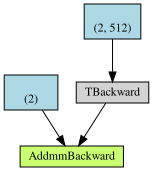

In [0]:
from torchviz import make_dot

x = torch.zeros(1, 3, 224, 224).to(device) #, dtype=torch.float, requires_grad=False)
out = residual_net(x)
make_dot(out)  

Why the computational graph built by Autograd is so small? 


Solution in 

3.

2.

1.

Since our purpose is to sketch the whole model, if we want to do it using the computational graph build by Autograd we have to reactivate the gradients.



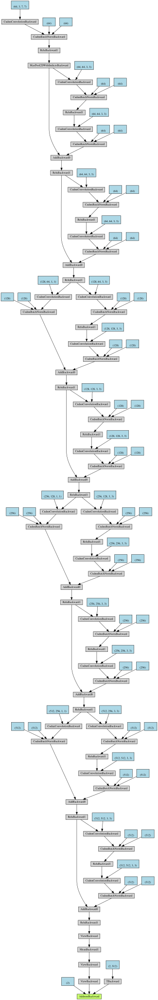

In [0]:
for param in residual_net.parameters():
    param.requires_grad = True
x = torch.zeros(1, 3, 224, 224).to(device) #, dtype=torch.float, requires_grad=False)
out = residual_net(x)
make_dot(out)

Do you see the skip connections?

Finally let's train our model!

In [0]:
# Before training we have to deactivate newly all the gradients except for the last layer
for param in residual_net.parameters():
    param.requires_grad = False
for param in residual_net.fc.parameters():
    param.requires_grad = True

num_epochs = 20

for epoch in range(num_epochs):

    # Evaluation 
    residual_net.eval()
    with torch.no_grad():
        misclassified = {'train': 0, 'val': 0}
        for ds in ['train', 'val']:
            for inputs, classes in dataloaders[ds]:
                inputs = inputs.to(device)
                classes = classes.to(device)
                outputs = residual_net(inputs)
                _, preds = torch.max(outputs, 1)
                misclassified[ds] += np.sum(torch.abs(preds - classes).cpu().numpy())

    accuracy_tr = 1 - misclassified['train'] / len(image_datasets['train'])
    accuracy_val = 1 - misclassified['val'] / len(image_datasets['val'])
    print(f'Epoch: {epoch} \t Training accuracy: {accuracy_tr:.3f} \tValidation accuracy: {accuracy_val:.3f}')

    # Training
    residual_net.train()
    for tr_inputs, tr_classes in dataloaders['train']:
        tr_inputs = tr_inputs.to(device)
        tr_classes = tr_classes.to(device)
        pred = residual_net(tr_inputs)
        loss = loss_func(pred, tr_classes)

        loss.backward()
        opt.step()
        opt.zero_grad()

    


In [0]:
inputs, classes = next(iter(dataloaders['val']))
_, predictions = torch.max(residual_net(inputs.to(device)), 1)
visualize_samples(inputs, title=f' ground truth: {[class_names[x] for x in classes]}<br>predictions: {[class_names[x] for x in predictions]}')

*Tutorial on transfer learning adapted from this [tutorial](https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html)*

>**EXERCISE**: Fine tune this model, try to add a [learning rate scheduler](https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate). What happen if you freeze less layers? Try to unfreeze the last residual block. And if you use [another pretrained model](https://pytorch.org/docs/stable/torchvision/models.html) larger than resnet18?